In [1]:
import scanpy as sc
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import scipy as sp
import scIB
import seaborn as sns

In [18]:
import warnings
warnings.filterwarnings("ignore")

In [2]:
sc.logging.print_versions()

scanpy==1.4.5.dev114+gd69832a anndata==0.7.1 umap==0.3.9 numpy==1.17.0 scipy==1.3.0 pandas==0.25.0 scikit-learn==0.22.1 statsmodels==0.10.1 python-igraph==0.7.1 louvain==0.6.1


In [55]:
plt.rcParams['figure.figsize'] = (15, 15)

In [97]:
plt.rcParams.update({'axes.titlesize': 'x-large'})

In [16]:
sns.set(font_scale=1.5, style='white')

In [95]:
sns.set_context('poster')

In [93]:
sns.set(font_scale=1.7)

In [90]:
sns.set_context("poster", rc={"axes.titlesize":60}) 

# User input

In [100]:
orig_file = '/storage/groups/ml01/workspace/group.daniela/immune_cells/Immune_ALL_human.h5ad'
#files = ['integration/unscaled/hvg/R/conos.h5ad', 'integration/scaled/hvg/scanorama.h5ad', 'integration/unscaled/hvg/R/seurat.h5ad', 'integration/unscaled/hvg/scanorama.h5ad', 'integration/scaled/hvg/mnn.h5ad']
best = ['integration/unscaled/hvg/R/conos.h5ad', 'integration/scaled/hvg/scanorama.h5ad', 'integration/scaled/hvg/mnn.h5ad', 'integration/unscaled/hvg/R/seurat.h5ad']
worst = ['integration/unscaled/full_feature/R/harmony.h5ad', 'integration/unscaled/hvg/R/liger.h5ad', 'integration/unscaled/full_feature/trvae.h5ad', 'integration/unscaled/full_feature/scvi.h5ad']
best_names = ['Conos (unscaled/hvg)', 'Scanorama(embedding) (scaled/hvg)', 'MNN (unscaled/hvg)', 'Seurat (unscaled/hvg)']
worst_names=['Harmony (unscaled/full feature)', 'Liger (unscaled/hvg)', 'trVAE (unscaled/full feature)', 'scIV (unscaled/full feature)']
best_types = ['knn', 'emb', 'gene', 'gene']
worst_types = ['emb', 'emb', 'gene', 'emb']
batch_key = 'batch'
ct_key = 'final_annotation'

In [14]:
#Lung atlas
lung_base = '/storage/groups/ml01/workspace/scIB/lung_atlas/'
lung_pre = '/storage/groups/ml01/workspace/group.daniela/lung/Lung_atlas_final_fixed.h5ad'
lung_best = ['integration/unscaled/full_feature/R/conos.h5ad', 'integration/unscaled/hvg/bbknn.h5ad',  'integration/scaled/hvg/scanorama.h5ad', 'integration/unscaled/hvg/mnn.h5ad']
lung_worst = ['integration/unscaled/full_feature/scanorama.h5ad', 'integration/scaled/hvg/R/seurat.h5ad', 'integration/unscaled/full_feature/scvi.h5ad', 'integration/unscaled/hvg/R/liger.h5ad']
lung_best_types = ['knn', 'knn', 'emb', 'gene']
lung_worst_types = ['gene', 'gene', 'emb', 'emb']
lung_batch = 'batch'
lung_ct = 'cell_type'


In [39]:
#Immune cell human
imm_base = '/storage/groups/ml01/workspace/scIB/immune_cell_hum/'
imm_pre = '/storage/groups/ml01/workspace/group.daniela/immune_cells/Immune_ALL_human.h5ad'
imm_best = ['integration/scaled/hvg/scanorama.h5ad', 'integration/unscaled/hvg/R/conos.h5ad', 'integration/unscaled/hvg/bbknn.h5ad', 'integration/unscaled/hvg/R/harmony.h5ad']
imm_worst = ['integration/unscaled/hvg/trvae.h5ad', 'integration/unscaled/full_feature/R/seurat.h5ad', 'integration/unscaled/hvg/R/liger.h5ad', 'integration/unscaled/full_feature/scvi.h5ad']
imm_best_types = ['emb', 'knn', 'knn', 'emb']
imm_worst_types = ['emb', 'gene', 'emb', 'emb']
imm_batch = 'batch'
imm_ct = 'final_annotation'


In [15]:
#Immune cell human mouse
imm2_base = '/storage/groups/ml01/workspace/scIB/immune_cell_hum_mou/'
imm2_pre = '/storage/groups/ml01/workspace/group.daniela/immune_cells/Immune_ALL_hum_mou.h5ad'
imm2_best = ['integration/scaled/hvg/scanorama.h5ad', 'integration/unscaled/hvg/bbknn.h5ad', 'integration/unscaled/full_feature/combat.h5ad', 'integration/scaled/hvg/mnn.h5ad']
imm2_worst = ['integration/scaled/hvg/R/conos.h5ad', 'integration/unscaled/full_feature/R/harmony.h5ad', 'integration/unscaled/full_feature/R/liger.h5ad', 'integration/unscaled/full_feature/scvi.h5ad']
imm2_best_types = ['emb', 'knn', 'gene', 'gene']
imm2_worst_types = ['knn', 'emb', 'emb', 'emb']
imm2_batch = 'batch'
imm2_ct = 'final_annotation'

In [4]:
#Simulations 1
sim1_base = '/storage/groups/ml01/workspace/scIB/simulations_1_1/'
sim1_pre = '/storage/groups/ml01/workspace/scIB/simulations_1_1/sim1_1_norm.h5ad'
sim1_best = ['integration/unscaled/full_feature/scanorama.h5ad', 'integration/unscaled/full_feature/R/seurat.h5ad', 'integration/unscaled/hvg/mnn.h5ad', 'integration/scaled/full_feature/R/conos.h5ad']
sim1_worst = ['integration/scaled/full_feature/bbknn.h5ad', 'integration/unscaled/hvg/trvae.h5ad','integration/unscaled/full_feature/mnn.h5ad', 'integration/unscaled/full_feature/scvi.h5ad']
sim1_best_types = ['emb', 'gene', 'gene', 'knn']
sim1_worst_types = ['knn', 'emb', 'gene', 'emb']
sim1_batch = 'Batch'
sim1_ct = 'Group'


In [42]:
#Simulations 2
sim2_base = '/storage/groups/ml01/workspace/scIB/simulations_2/'
sim2_pre = '/storage/groups/ml01/workspace/scIB/simulations_2/sim2_norm.h5ad'
sim2_best = ['integration/scaled/hvg/R/seurat.h5ad', 'integration/scaled/hvg/R/harmony.h5ad', 'integration/scaled/full_feature/R/conos.h5ad',  'integration/unscaled/hvg/bbknn.h5ad']
sim2_worst = ['integration/unscaled/full_feature/combat.h5ad', 'integration/scaled/full_feature/scanorama.h5ad', 'integration/unscaled/full_feature/R/harmony.h5ad', 'integration/unscaled/full_feature/scvi.h5ad']
sim2_best_types = ['gene', 'emb', 'knn', 'knn']
sim2_worst_types = ['gene', 'gene', 'emb', 'emb']
sim2_batch = 'SubBatch'
sim2_ct = 'Group'


In [11]:
#Pancreas
panc_base = '/storage/groups/ml01/workspace/scIB/pancreas/'
panc_pre = '/storage/groups/ml01/workspace/maren.buettner/data_integration/data/human_pancreas/human_pancreas_norm.h5ad'
panc_best = ['integration/scaled/full_feature/R/conos.h5ad', 'integration/scaled/hvg/R/seurat.h5ad', 'integration/scaled/hvg/scanorama.h5ad',  'integration/scaled/hvg/R/harmony.h5ad']
panc_worst = ['integration/unscaled/full_feature/scanorama.h5ad', 'integration/unscaled/hvg/R/liger.h5ad','integration/unscaled/full_feature/R/harmony.h5ad', 'integration/unscaled/full_feature/scvi.h5ad']
panc_best_types = ['knn', 'gene', 'emb', 'emb']
panc_worst_types = ['gene', 'emb', 'emb', 'emb']
panc_batch = 'tech'
panc_ct = 'celltype'


In [13]:
#Pancreas
panc_base = '/storage/groups/ml01/workspace/scIB/pancreas_jointnorm/'
panc_pre = '/storage/groups/ml01/workspace/scIB/pancreas_joint/pancreas_jointnorm.h5ad'
panc_best = ['integration/unscaled/hvg/R/seurat.h5ad', 'integration/unscaled/hvg/bbknn.h5ad', 'integration/scaled/full_feature/R/conos.h5ad', 'integration/scaled/hvg/scanorama.h5ad']
panc_worst = ['integration/unscaled/full_feature/mnn.h5ad', 'integration/unscaled/full_feature/scanorama.h5ad', 'integration/unscaled/hvg/R/liger.h5ad', 'integration/unscaled/full_feature/scvi.h5ad']
panc_best_types = ['gene', 'knn', 'knn', 'emb']
panc_worst_types = ['gene', 'gene', 'emb', 'emb']
panc_batch = 'tech'
panc_ct = 'celltype'

In [53]:
# Mouse Brain
brain_base = '/home/icb/chaichoompu/Group/workspace/scib_result_rna_big_neu01_03/mouse_brain/'
brain_pre = '/storage/groups/ml01/workspace/maren.buettner/data_integration/data/mouse_brain/mouse_brain_norm.h5ad'
brain_best = ['integration/scaled/hvg/bbknn.h5ad', 'integration/unscaled/hvg/combat.h5ad', 'integration/unscaled/hvg/R/liger.h5ad',  'integration/scaled/hvg/scanorama.h5ad']
brain_worst = ['integration/unscaled/hvg/R/conos.h5ad', 'integration/unscaled/full_feature/R/harmony.h5ad','integration/unscaled/full_feature/scanorama.h5ad', 'integration/unscaled/full_feature/scvi.h5ad']
brain_best_types = ['knn', 'gene', 'emb', 'gene']
brain_worst_types = ['knn', 'emb', 'gene', 'emb']
brain_batch = 'study'
brain_ct = 'cell_type'

# Read files

In [6]:
def make_names(fnames):
    names = []
    for i in fnames:
        s = i.split('/')
        names.append(s[len(s)-1].split(".")[0] +" ("+s[1]+"/"+s[2]+")")
    return names

In [7]:
def read_data(base, pre, best, worst, best_types, worst_types):
    adata_pre = sc.read(pre)
    adatas_best = dict()
    adatas_worst = dict()
    best_names = make_names(best)
    worst_names = make_names(worst)
    for idx,file in enumerate(best):
        adatas_best[best_names[idx]] = (sc.read(base+file), best_types[idx])
    for idx,file in enumerate(worst):
        adatas_worst[worst_names[idx]] = (sc.read(base+file), worst_types[idx])
    return adata_pre, adatas_best, adatas_worst

In [8]:
# Transfer annotations from pervious object
def match_anns(adata, adata_pre, batch_key='batch'):
    # Match annotations:
    if len(set(adata_pre.obs_names).difference(set(adata.obs_names))) > 0:
        new_obs_names = ['-'.join(idx.split('-')[:-1]) for idx in adata.obs_names]
        if len(set(adata_pre.obs_names).difference(set(new_obs_names))) == 0:
            adata.obs_names = new_obs_names
        else:
            raise ValueError('obs_names changed after integration!')

    adata.obs[batch_key] = adata.obs[batch_key].astype('category')

    if not np.array_equal(adata_pre.obs[batch_key].cat.categories,adata.obs[batch_key].cat.categories):
        adata.obs[batch_key] = adata_pre.obs[batch_key]


In [9]:
# Preprocessing loop
def pp(adatas, a_pre, batch_key):
    for key in adatas:
        print(f'preprocessing {key}...')
        ot = adatas[key][1]
        dat = adatas[key][0]
    
        # Ensure annotations are matched
        match_anns(dat, a_pre, batch_key)
    
        if ot == 'knn':
            if 'params' not in dat.uns['neighbors']:
                dat.uns['neighbors']['params'] = dict(n_pcs=dat.obsm['X_pca'].shape[1],
                                                      use_rep='X_pca',
                                                      metric='cosine',
                                                      method='umap',
                                                      n_neighbors=10)
            
            sc.tl.umap(dat)
        
        elif ot == 'emb':
            scIB.pp.reduce_data(dat, n_top_genes=None, neighbors=True, use_rep='X_emb', pca=True, umap=True)
        
        elif ot == 'gene':
            if key.startswith('tr'):
                sc.pp.filter_genes(dat, min_cells=1)
            scIB.pp.reduce_data(dat, n_top_genes=2000, neighbors=True, use_rep='X_pca', pca=True, umap=True)
        if key.startswith('conos'):
            print('conos comp graph')
            sc.tl.draw_graph(dat)

In [75]:
# Visualization loop
def viz(adatas_best, adatas_worst, var, axs):
    #fig, axs = plt.subplots(2, 4, figsize=(40,16))
    start = 1
    for key in adatas_best:
        dat = adatas_best[key][0]
        if key.startswith('con'):
            print('conos draw graph')
            sc.pl.draw_graph(dat, color=var, size=20, title=key, legend_loc="", legend_fontsize='x-large', ax=axs[start], show=False, frameon=False)
        else:
            sc.pl.umap(dat, color=var, size=20, title=key, legend_loc="", legend_fontsize='x-large', ax=axs[start], show=False, frameon=False)
        start+=1
    #start=0
    for key in adatas_worst:
        dat = adatas_worst[key][0]
        
        if key.startswith('con'):
            print('conos draw graph')
            sc.pl.draw_graph(dat, color=var, size=20, title=key, legend_loc="", legend_fontsize='x-large', ax=axs[start], show=False, frameon=False)

        sc.pl.umap(dat, color=var, size=20, title=key, legend_loc="", legend_fontsize='x-large', ax=axs[start], show=False, frameon=False)
        start+=1
    #plt.savefig('figures/integrated.svg')
        #sc.pl.umap(dat, color=ct_key, size=20, title=key)

In [88]:
def make_grid():
    fig = plt.figure(constrained_layout=True, figsize=[40,12])
    gs = fig.add_gridspec(2, 6)
    axs = []
    axs.append(fig.add_subplot(gs[:,0:2]))
    axs.append(fig.add_subplot(gs[0,2]))
    axs.append(fig.add_subplot(gs[0,3]))
    axs.append(fig.add_subplot(gs[0,4]))
    axs.append(fig.add_subplot(gs[0,5]))
    axs.append(fig.add_subplot(gs[1,2]))
    axs.append(fig.add_subplot(gs[1,3]))
    axs.append(fig.add_subplot(gs[1,4]))
    axs.append(fig.add_subplot(gs[1,5]))
    return fig, axs

In [89]:
def draw_figure(base, pre, best, worst, best_types, worst_types, batch, ct):
    a_pre, a_best, a_worst = read_data(base, pre, best, worst, best_types, worst_types)
    print('Data reading successful')
    scIB.pp.reduce_data(a_pre, n_top_genes=2000, neighbors=True, use_rep='X_pca', pca=True, umap=True)
    pp(a_best, a_pre, batch)
    pp(a_worst, a_pre, batch)
    fig, axs = make_grid()
    sc.pl.umap(a_pre, title="Batch", color=batch, frameon=False, ax=axs[0])
    viz(a_best, a_worst, batch, axs=axs)
    fig_2, axs_2 = make_grid()
    sc.pl.umap(a_pre, title="Cell type", color=ct, frameon=False, ax=axs_2[0])
    viz(a_best, a_worst, ct, axs=axs_2)
    return a_best, a_worst

Data reading successful
HVG
Calculating 2000 HVGs for reduce_data.
Computed 1999 highly variable genes
PCA
Nearest Neigbours


/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/numba/compiler.py:602: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/nndescent.py", line 47:
    @numba.njit(parallel=True)
    def nn_descent(
    ^

  self.func_ir.loc))


UMAP
preprocessing seurat (unscaled/hvg)...
HVG
Calculating 2000 HVGs for reduce_data.
Computed 1999 highly variable genes
PCA
Nearest Neigbours


/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/numba/compiler.py:602: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/nndescent.py", line 47:
    @numba.njit(parallel=True)
    def nn_descent(
    ^

  self.func_ir.loc))


UMAP
preprocessing bbknn (unscaled/hvg)...
preprocessing conos (scaled/full_feature)...
conos comp graph
preprocessing scanorama (scaled/hvg)...
PCA
Nearest Neigbours


/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/numba/compiler.py:602: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/nndescent.py", line 47:
    @numba.njit(parallel=True)
    def nn_descent(
    ^

  self.func_ir.loc))


UMAP
preprocessing mnn (unscaled/full_feature)...
HVG
Calculating 2000 HVGs for reduce_data.
Computed 2000 highly variable genes
PCA
Nearest Neigbours


/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/numba/compiler.py:602: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/nndescent.py", line 47:
    @numba.njit(parallel=True)
    def nn_descent(
    ^

  self.func_ir.loc))


UMAP
preprocessing scanorama (unscaled/full_feature)...
HVG
Calculating 2000 HVGs for reduce_data.
Computed 1999 highly variable genes
PCA
Nearest Neigbours


/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/numba/compiler.py:602: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/nndescent.py", line 47:
    @numba.njit(parallel=True)
    def nn_descent(
    ^

  self.func_ir.loc))


UMAP
preprocessing liger (unscaled/hvg)...
PCA
Nearest Neigbours


/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/numba/compiler.py:602: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/nndescent.py", line 47:
    @numba.njit(parallel=True)
    def nn_descent(
    ^

  self.func_ir.loc))


UMAP
preprocessing scvi (unscaled/full_feature)...
PCA
Nearest Neigbours


/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/numba/compiler.py:602: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/nndescent.py", line 47:
    @numba.njit(parallel=True)
    def nn_descent(
    ^

  self.func_ir.loc))


UMAP


'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches

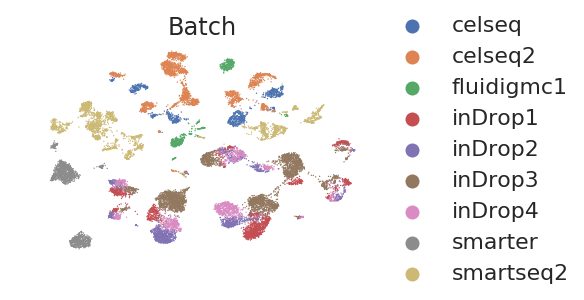

conos draw graph


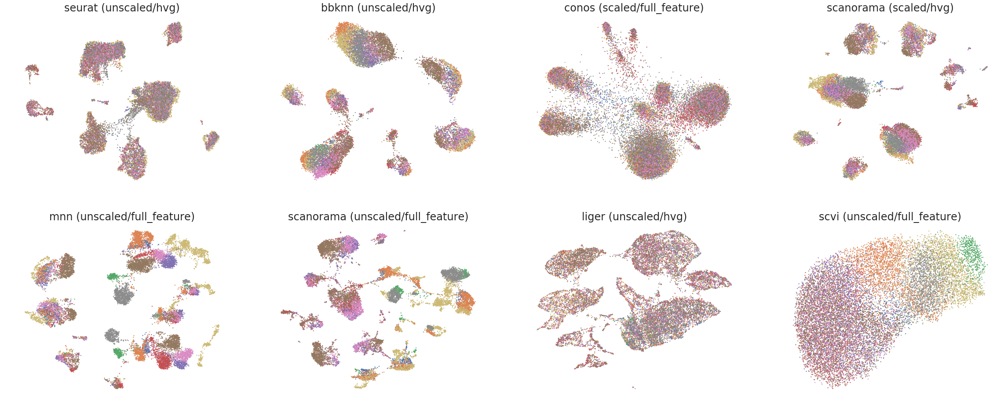

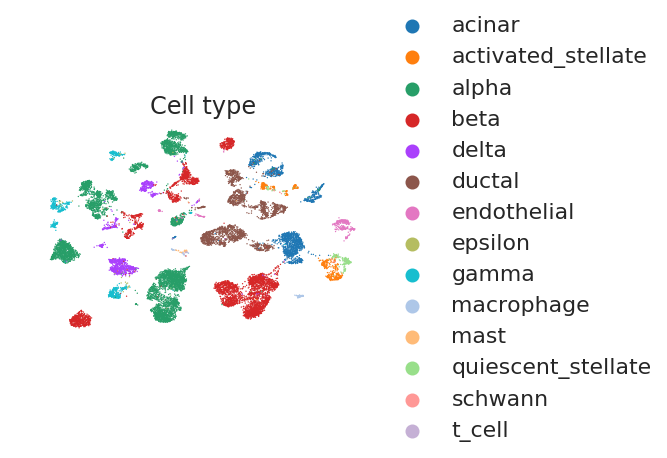

conos draw graph


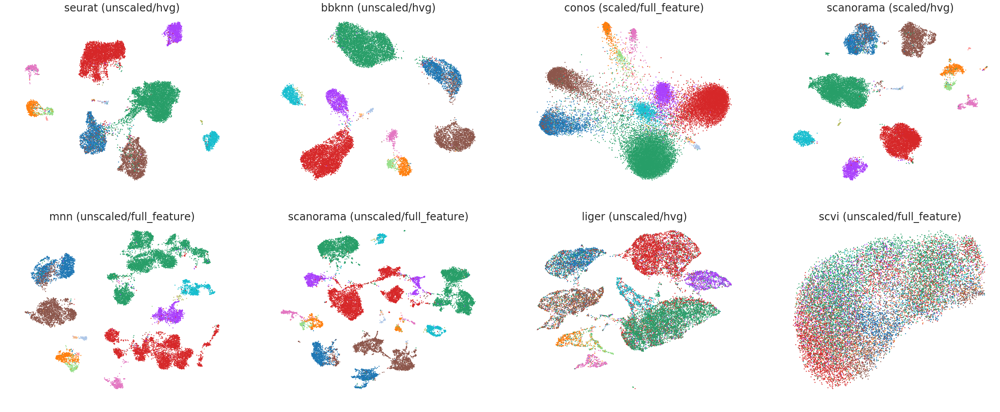

In [36]:
# panc jointnorm
draw_figure(panc_base, panc_pre, panc_best, panc_worst, panc_best_types, panc_worst_types, panc_batch, panc_ct)

Data reading successful
HVG
Calculating 2000 HVGs for reduce_data.
Computed 1999 highly variable genes
PCA
Nearest Neigbours


/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/rp_tree.py:450: NumbaWarning: 
Compilation is falling back to object mode WITH looplifting enabled because Function "make_euclidean_tree" failed type inference due to: Cannot unify RandomProjectionTreeNode(array(int64, 1d, C), bool, none, none, none, none) and RandomProjectionTreeNode(none, bool, array(float32, 1d, C), float64, RandomProjectionTreeNode(array(int64, 1d, C), bool, none, none, none, none), RandomProjectionTreeNode(array(int64, 1d, C), bool, none, none, none, none)) for '$14.16', defined at /home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/rp_tree.py (457)

File "../../miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/rp_tree.py", line 457:
def make_euclidean_tree(data, indices, rng_state, leaf_size=30):
    <source elided>

        left_node = make_euclidean_tree(data, left_indices, rng_state, leaf_size)
        ^

[1] During: resolving callee

UMAP
preprocessing conos (unscaled/full_feature)...
conos comp graph
preprocessing bbknn (unscaled/hvg)...
preprocessing scanorama (scaled/hvg)...
PCA
Nearest Neigbours


/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/rp_tree.py:450: NumbaWarning: 
Compilation is falling back to object mode WITH looplifting enabled because Function "make_euclidean_tree" failed type inference due to: Cannot unify RandomProjectionTreeNode(array(int64, 1d, C), bool, none, none, none, none) and RandomProjectionTreeNode(none, bool, array(float32, 1d, C), float64, RandomProjectionTreeNode(array(int64, 1d, C), bool, none, none, none, none), RandomProjectionTreeNode(array(int64, 1d, C), bool, none, none, none, none)) for '$14.16', defined at /home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/rp_tree.py (457)

File "../../miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/rp_tree.py", line 457:
def make_euclidean_tree(data, indices, rng_state, leaf_size=30):
    <source elided>

        left_node = make_euclidean_tree(data, left_indices, rng_state, leaf_size)
        ^

[1] During: resolving callee

UMAP
preprocessing mnn (unscaled/hvg)...
HVG
Calculating 2000 HVGs for reduce_data.
Computed 2000 highly variable genes
PCA
Nearest Neigbours


/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/numba/compiler.py:602: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/nndescent.py", line 47:
    @numba.njit(parallel=True)
    def nn_descent(
    ^

  self.func_ir.loc))


UMAP
preprocessing scanorama (scaled/full_feature)...
HVG
Calculating 2000 HVGs for reduce_data.
Computed 2000 highly variable genes
PCA
Nearest Neigbours


/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/numba/compiler.py:602: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/nndescent.py", line 47:
    @numba.njit(parallel=True)
    def nn_descent(
    ^

  self.func_ir.loc))


UMAP


/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/spectral.py:229: UserWarning: Embedding a total of 13 separate connected components using meta-embedding (experimental)
  n_components


preprocessing seurat (scaled/hvg)...
HVG
Calculating 2000 HVGs for reduce_data.
Computed 2000 highly variable genes
PCA
Nearest Neigbours


/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/numba/compiler.py:602: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/nndescent.py", line 47:
    @numba.njit(parallel=True)
    def nn_descent(
    ^

  self.func_ir.loc))


UMAP
preprocessing scvi (unscaled/full_feature)...
PCA
Nearest Neigbours


/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/rp_tree.py:450: NumbaWarning: 
Compilation is falling back to object mode WITH looplifting enabled because Function "make_euclidean_tree" failed type inference due to: Cannot unify RandomProjectionTreeNode(array(int64, 1d, C), bool, none, none, none, none) and RandomProjectionTreeNode(none, bool, array(float32, 1d, C), float64, RandomProjectionTreeNode(array(int64, 1d, C), bool, none, none, none, none), RandomProjectionTreeNode(array(int64, 1d, C), bool, none, none, none, none)) for '$14.16', defined at /home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/rp_tree.py (457)

File "../../miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/rp_tree.py", line 457:
def make_euclidean_tree(data, indices, rng_state, leaf_size=30):
    <source elided>

        left_node = make_euclidean_tree(data, left_indices, rng_state, leaf_size)
        ^

[1] During: resolving callee

UMAP
preprocessing liger (unscaled/hvg)...
PCA
Nearest Neigbours


/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/numba/compiler.py:602: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/nndescent.py", line 47:
    @numba.njit(parallel=True)
    def nn_descent(
    ^

  self.func_ir.loc))


UMAP


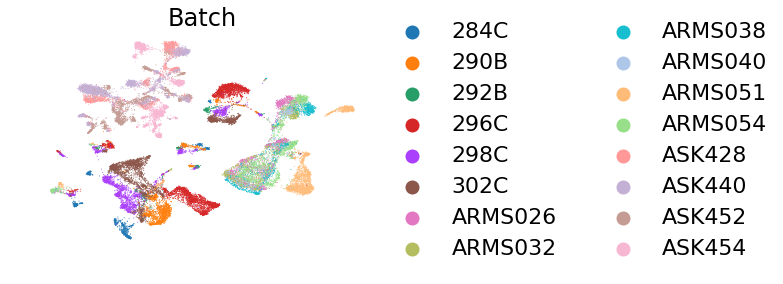

conos draw graph


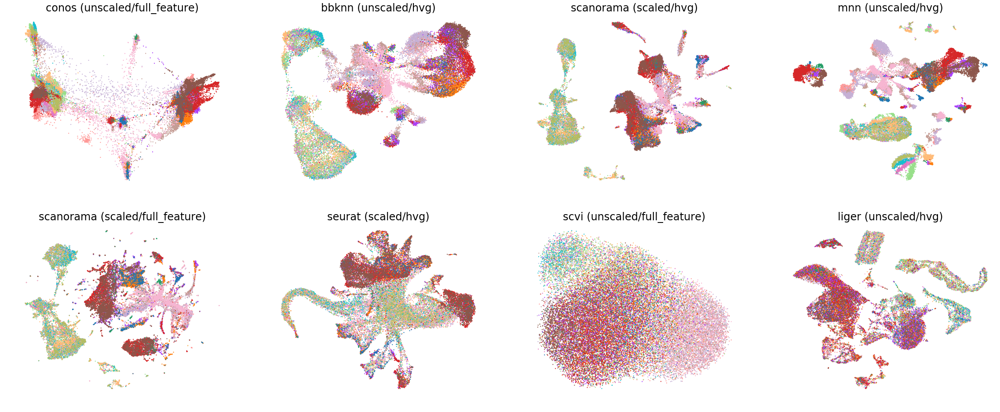

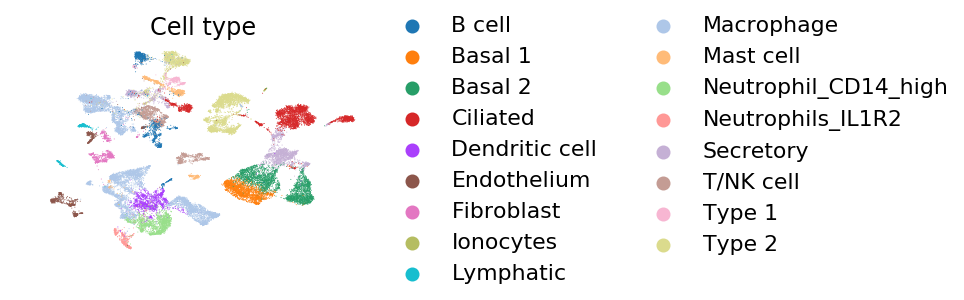

conos draw graph


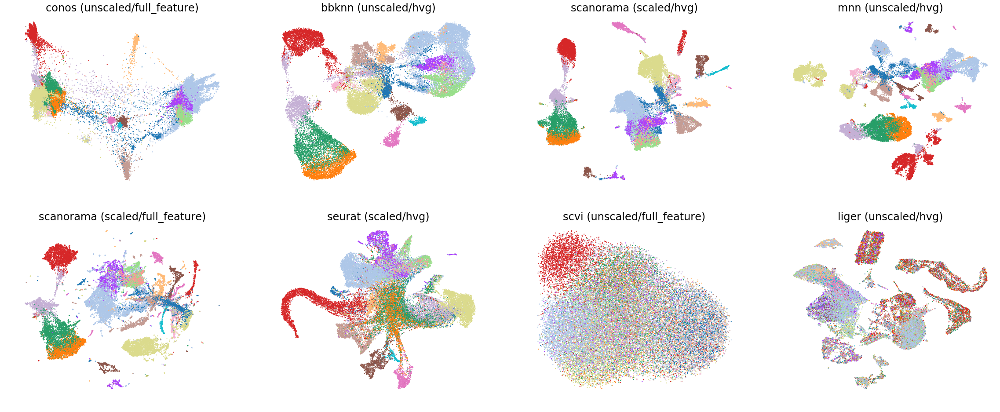

In [12]:
draw_figure(lung_base, lung_pre, lung_best, lung_worst, lung_best_types, lung_worst_types, lung_batch, lung_ct)

Data reading successful
HVG
Calculating 2000 HVGs for reduce_data.
Computed 2000 highly variable genes
PCA
Nearest Neigbours


/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/numba/compiler.py:602: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/nndescent.py", line 47:
    @numba.njit(parallel=True)
    def nn_descent(
    ^

  self.func_ir.loc))


UMAP


/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/spectral.py:229: UserWarning: Embedding a total of 3 separate connected components using meta-embedding (experimental)
  n_components


preprocessing scanorama (scaled/hvg)...
PCA
Nearest Neigbours


/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/numba/compiler.py:602: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/nndescent.py", line 47:
    @numba.njit(parallel=True)
    def nn_descent(
    ^

  self.func_ir.loc))


UMAP
preprocessing conos (unscaled/hvg)...
conos comp graph
preprocessing bbknn (unscaled/hvg)...
preprocessing harmony (unscaled/hvg)...
PCA
Nearest Neigbours


/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/numba/compiler.py:602: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/nndescent.py", line 47:
    @numba.njit(parallel=True)
    def nn_descent(
    ^

  self.func_ir.loc))


UMAP
preprocessing trvae (unscaled/hvg)...
PCA
Nearest Neigbours


/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/numba/compiler.py:602: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/nndescent.py", line 47:
    @numba.njit(parallel=True)
    def nn_descent(
    ^

  self.func_ir.loc))


UMAP
preprocessing seurat (unscaled/full_feature)...
HVG
Calculating 2000 HVGs for reduce_data.
Computed 1999 highly variable genes
PCA
Nearest Neigbours


/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/numba/compiler.py:602: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/nndescent.py", line 47:
    @numba.njit(parallel=True)
    def nn_descent(
    ^

  self.func_ir.loc))


UMAP
preprocessing liger (unscaled/hvg)...
PCA
Nearest Neigbours


/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/numba/compiler.py:602: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/nndescent.py", line 47:
    @numba.njit(parallel=True)
    def nn_descent(
    ^

  self.func_ir.loc))


UMAP
preprocessing scvi (unscaled/full_feature)...
PCA
Nearest Neigbours


/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/numba/compiler.py:602: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/nndescent.py", line 47:
    @numba.njit(parallel=True)
    def nn_descent(
    ^

  self.func_ir.loc))


UMAP


'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches

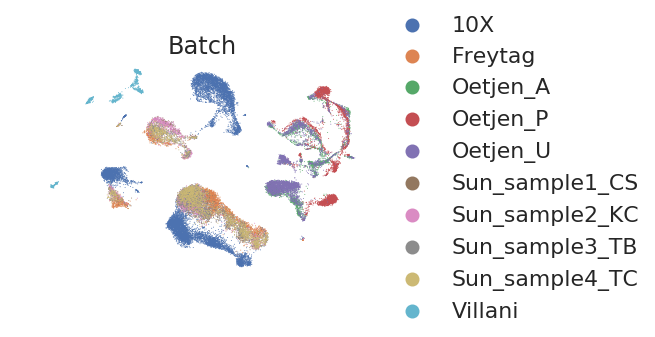

conos draw graph


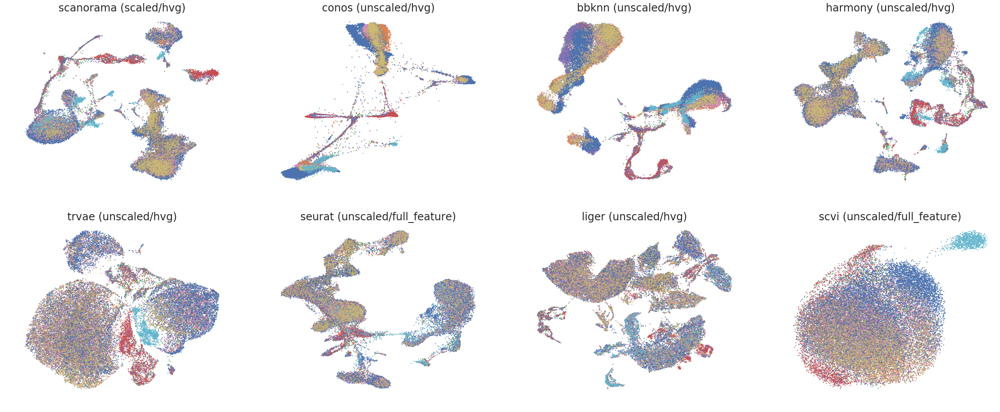

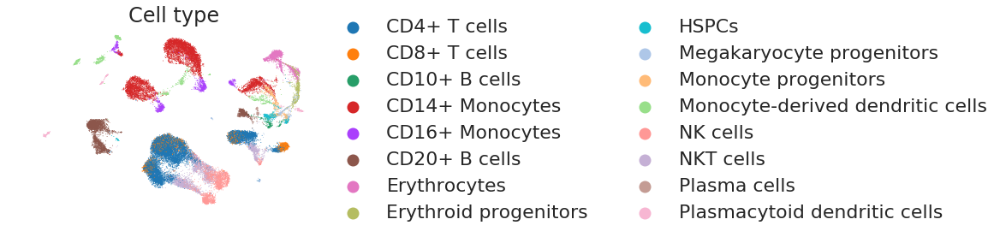

conos draw graph


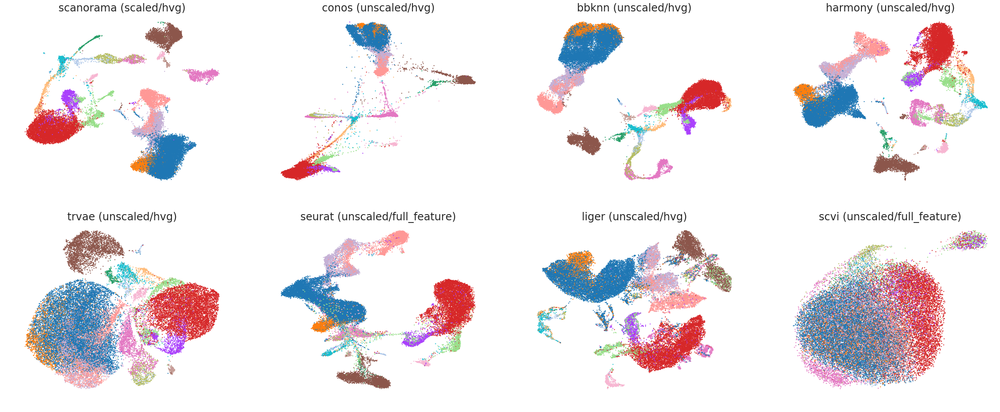

In [40]:
draw_figure(imm_base, imm_pre, imm_best, imm_worst, imm_best_types, imm_worst_types, imm_batch, imm_ct)

Data reading successful
HVG
Calculating 2000 HVGs for reduce_data.
Computed 1999 highly variable genes
PCA
Nearest Neigbours
UMAP
preprocessing scanorama (scaled/hvg)...
PCA
Nearest Neigbours
UMAP
preprocessing bbknn (unscaled/hvg)...
preprocessing combat (unscaled/full_feature)...
HVG
Calculating 2000 HVGs for reduce_data.
Computed 1999 highly variable genes
PCA
Nearest Neigbours
UMAP
preprocessing mnn (scaled/hvg)...
HVG
Calculating 2000 HVGs for reduce_data.
Computed 1999 highly variable genes
PCA
Nearest Neigbours
UMAP
preprocessing conos (scaled/hvg)...
conos comp graph
preprocessing harmony (unscaled/full_feature)...
PCA
Nearest Neigbours
UMAP
preprocessing liger (unscaled/full_feature)...
PCA
Nearest Neigbours
UMAP
preprocessing scvi (unscaled/full_feature)...
PCA
Nearest Neigbours
UMAP


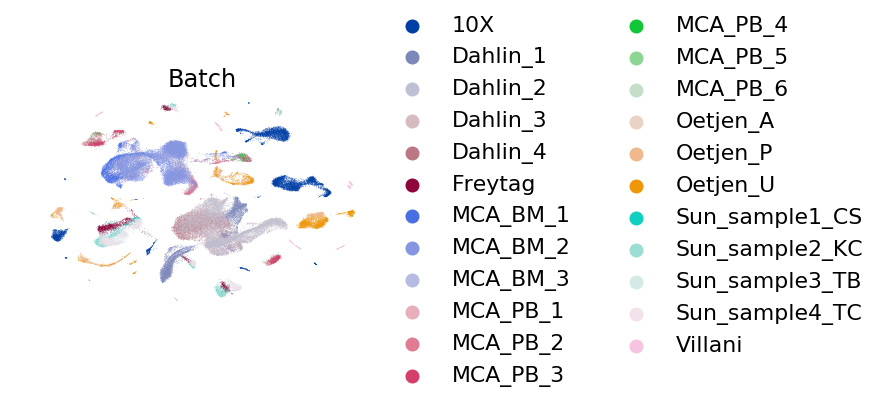

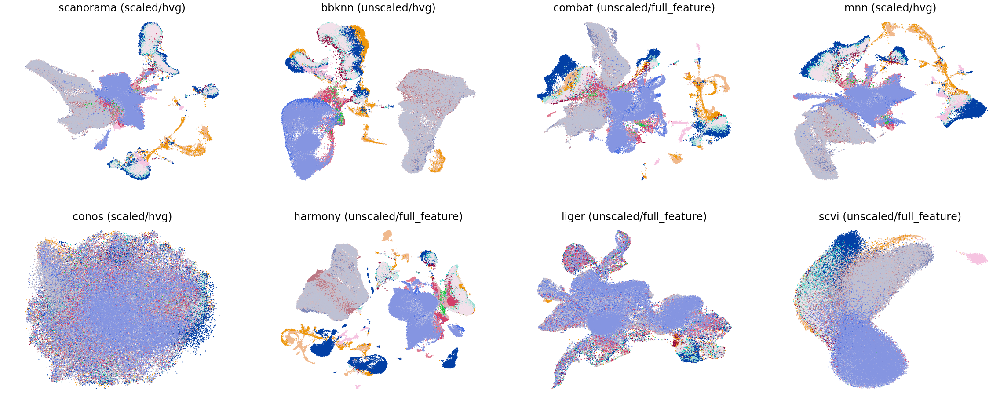

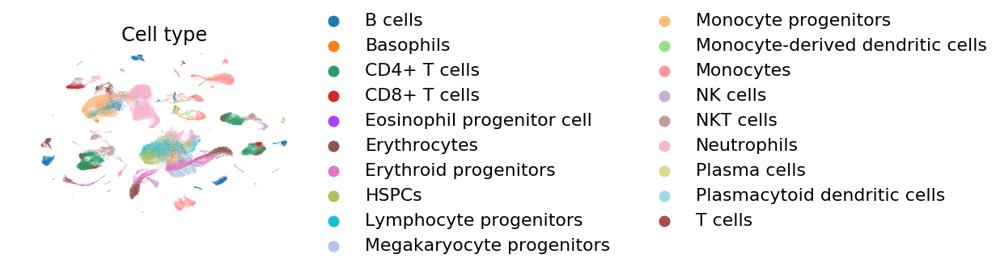

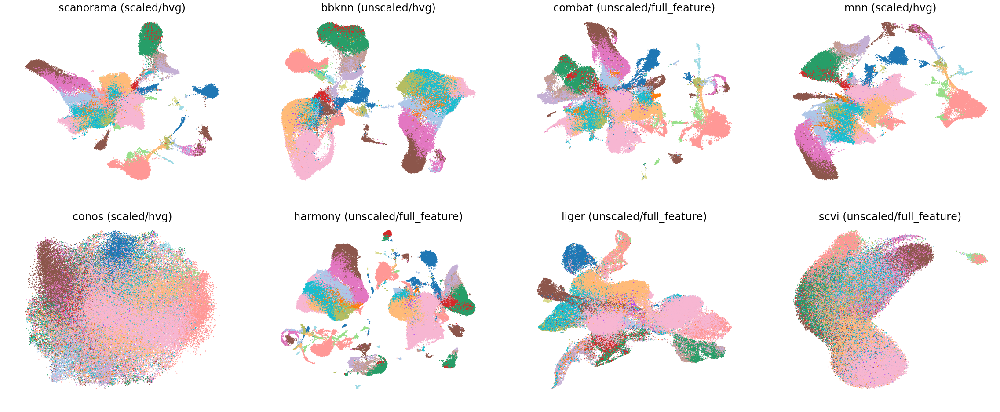

In [19]:
imm2best, imm2worst = draw_figure(imm2_base, imm2_pre, imm2_best, imm2_worst, imm2_best_types, imm2_worst_types, imm2_batch, imm2_ct)

In [52]:
imm2_u = sc.read(imm2_pre)
scIB.pp.reduce_data(imm2_u)

HVG
Calculating 2000 HVGs for reduce_data.
Computed 1999 highly variable genes
PCA
Nearest Neigbours
UMAP


conos draw graph


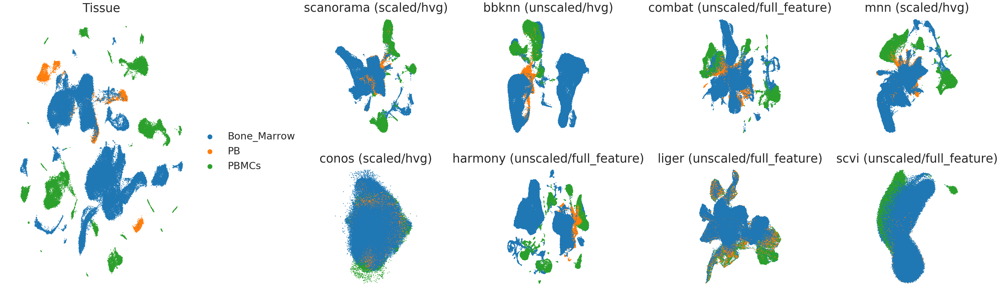

In [98]:
fig, axs = make_grid()

sc.pl.umap(imm2_u, color='tissue', size=20, title='Tissue', legend_fontsize='large', frameon=False, show=False, ax=axs[0])
viz(imm2best, imm2worst, 'tissue', axs)
plt.savefig('imm2_tissue.pdf')

In [102]:
imm2_u.obs.to_csv('imm_cell_hum.csv')

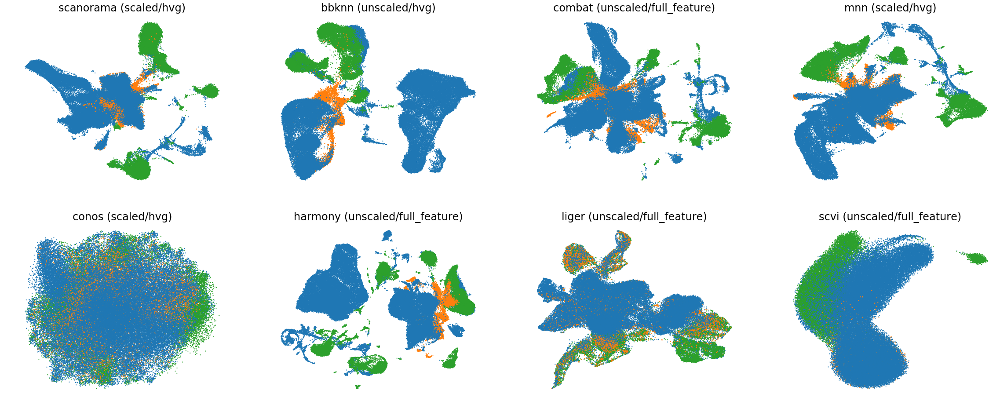

In [49]:
viz(imm2best, imm2worst, 'tissue')

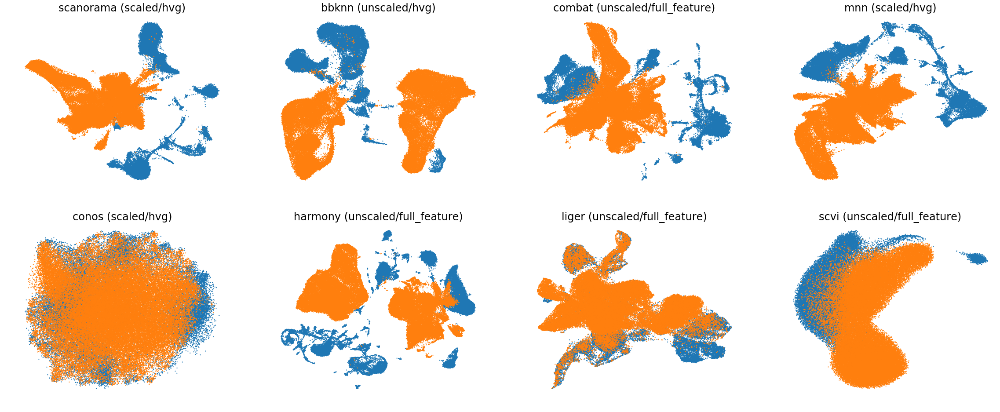

In [50]:
viz(imm2best, imm2worst, 'species')

Data reading successful
HVG
Calculating 2000 HVGs for reduce_data.
Computed 1999 highly variable genes
PCA
Nearest Neigbours


/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/numba/compiler.py:602: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/nndescent.py", line 47:
    @numba.njit(parallel=True)
    def nn_descent(
    ^

  self.func_ir.loc))


UMAP


/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/spectral.py:229: UserWarning: Embedding a total of 30 separate connected components using meta-embedding (experimental)
  n_components


preprocessing scanorama (unscaled/full_feature)...
PCA
Nearest Neigbours


/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/numba/compiler.py:602: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/nndescent.py", line 47:
    @numba.njit(parallel=True)
    def nn_descent(
    ^

  self.func_ir.loc))


UMAP


/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/spectral.py:229: UserWarning: Embedding a total of 7 separate connected components using meta-embedding (experimental)
  n_components


preprocessing seurat (unscaled/full_feature)...
HVG
Calculating 2000 HVGs for reduce_data.
Computed 2000 highly variable genes
PCA
Nearest Neigbours


/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/numba/compiler.py:602: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/nndescent.py", line 47:
    @numba.njit(parallel=True)
    def nn_descent(
    ^

  self.func_ir.loc))


UMAP


/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/spectral.py:229: UserWarning: Embedding a total of 2 separate connected components using meta-embedding (experimental)
  n_components


preprocessing mnn (unscaled/hvg)...
HVG
Calculating 2000 HVGs for reduce_data.
Computed 2000 highly variable genes
PCA
Nearest Neigbours


/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/numba/compiler.py:602: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/nndescent.py", line 47:
    @numba.njit(parallel=True)
    def nn_descent(
    ^

  self.func_ir.loc))


UMAP


/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/spectral.py:229: UserWarning: Embedding a total of 5 separate connected components using meta-embedding (experimental)
  n_components


preprocessing conos (scaled/full_feature)...
conos comp graph
preprocessing bbknn (scaled/full_feature)...
preprocessing trvae (unscaled/hvg)...
PCA
Nearest Neigbours


/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/numba/compiler.py:602: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/nndescent.py", line 47:
    @numba.njit(parallel=True)
    def nn_descent(
    ^

  self.func_ir.loc))


UMAP
preprocessing mnn (unscaled/full_feature)...
HVG
Calculating 2000 HVGs for reduce_data.
Computed 2000 highly variable genes
PCA
Nearest Neigbours


/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/numba/compiler.py:602: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/nndescent.py", line 47:
    @numba.njit(parallel=True)
    def nn_descent(
    ^

  self.func_ir.loc))


UMAP


/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/spectral.py:229: UserWarning: Embedding a total of 6 separate connected components using meta-embedding (experimental)
  n_components


preprocessing scvi (unscaled/full_feature)...
PCA
Nearest Neigbours


/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/numba/compiler.py:602: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/nndescent.py", line 47:
    @numba.njit(parallel=True)
    def nn_descent(
    ^

  self.func_ir.loc))


UMAP


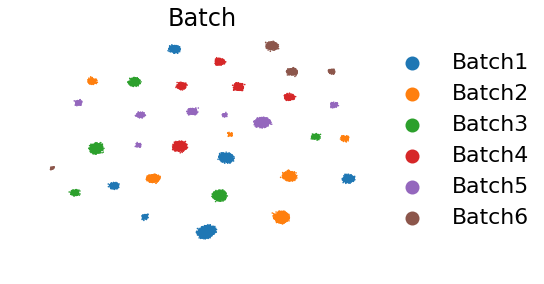

conos draw graph


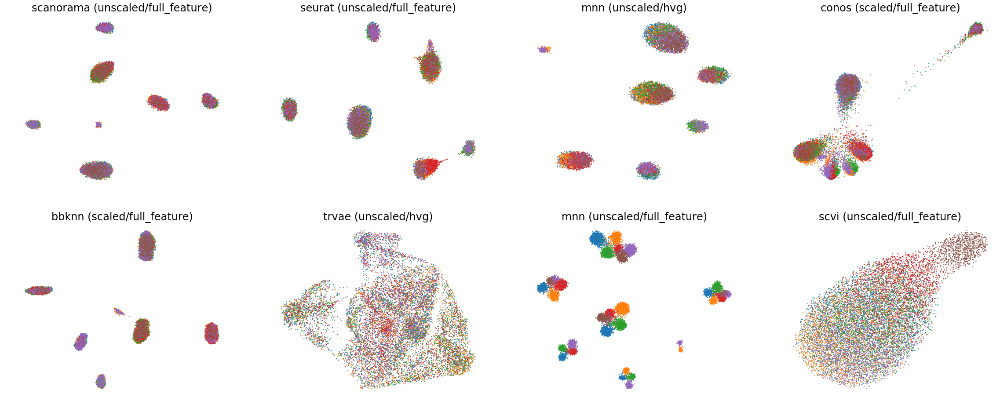

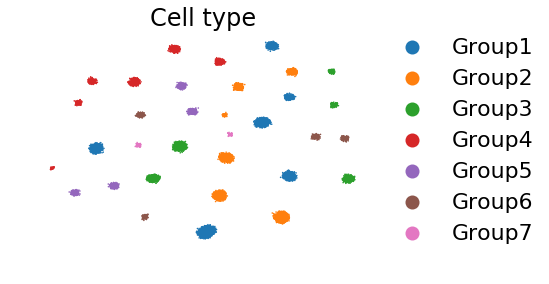

conos draw graph


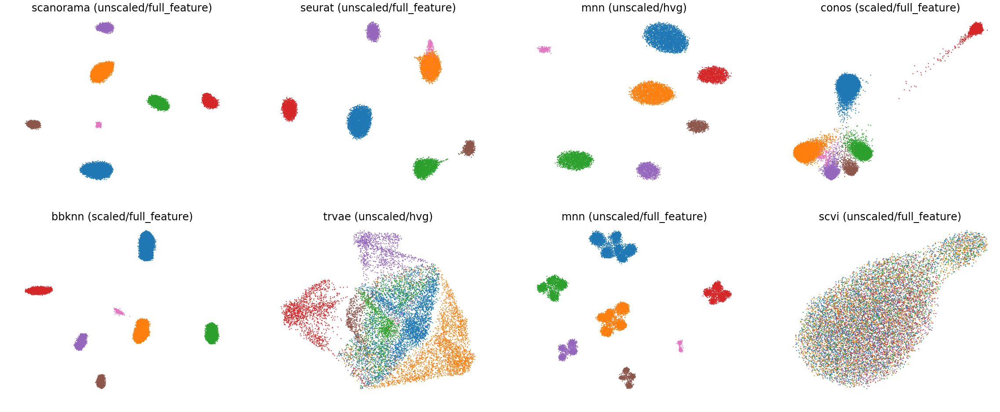

In [13]:
draw_figure(sim1_base, sim1_pre, sim1_best, sim1_worst, sim1_best_types, sim1_worst_types, sim1_batch, sim1_ct)

Data reading successful
HVG
Calculating 2000 HVGs for reduce_data.
Computed 2000 highly variable genes
PCA
Nearest Neigbours


/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/numba/compiler.py:602: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/nndescent.py", line 47:
    @numba.njit(parallel=True)
    def nn_descent(
    ^

  self.func_ir.loc))


UMAP


/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/spectral.py:229: UserWarning: Embedding a total of 14 separate connected components using meta-embedding (experimental)
  n_components


preprocessing seurat (scaled/hvg)...
HVG
Calculating 2000 HVGs for reduce_data.
Computed 2000 highly variable genes
PCA
Nearest Neigbours


/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/numba/compiler.py:602: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/nndescent.py", line 47:
    @numba.njit(parallel=True)
    def nn_descent(
    ^

  self.func_ir.loc))


UMAP


/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/spectral.py:229: UserWarning: Embedding a total of 2 separate connected components using meta-embedding (experimental)
  n_components


preprocessing harmony (scaled/hvg)...
PCA
Nearest Neigbours


/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/numba/compiler.py:602: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/nndescent.py", line 47:
    @numba.njit(parallel=True)
    def nn_descent(
    ^

  self.func_ir.loc))


UMAP


/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/spectral.py:229: UserWarning: Embedding a total of 2 separate connected components using meta-embedding (experimental)
  n_components


preprocessing conos (scaled/full_feature)...
conos comp graph
preprocessing bbknn (unscaled/hvg)...
preprocessing combat (unscaled/full_feature)...
HVG
Calculating 2000 HVGs for reduce_data.
Computed 1999 highly variable genes
PCA
Nearest Neigbours


/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/numba/compiler.py:602: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/nndescent.py", line 47:
    @numba.njit(parallel=True)
    def nn_descent(
    ^

  self.func_ir.loc))


UMAP


/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/spectral.py:229: UserWarning: Embedding a total of 8 separate connected components using meta-embedding (experimental)
  n_components


preprocessing scanorama (scaled/full_feature)...
HVG
Calculating 2000 HVGs for reduce_data.
Computed 1999 highly variable genes
PCA
Nearest Neigbours


/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/numba/compiler.py:602: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/nndescent.py", line 47:
    @numba.njit(parallel=True)
    def nn_descent(
    ^

  self.func_ir.loc))


UMAP


/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/spectral.py:229: UserWarning: Embedding a total of 6 separate connected components using meta-embedding (experimental)
  n_components


preprocessing harmony (unscaled/full_feature)...
PCA
Nearest Neigbours


/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/numba/compiler.py:602: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/nndescent.py", line 47:
    @numba.njit(parallel=True)
    def nn_descent(
    ^

  self.func_ir.loc))


UMAP


/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/spectral.py:229: UserWarning: Embedding a total of 10 separate connected components using meta-embedding (experimental)
  n_components
/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/sklearn/manifold/_spectral_embedding.py:236: UserWarning: Graph is not fully connected, spectral embedding may not work as expected.
  warnings.warn("Graph is not fully connected, spectral embedding"


preprocessing scvi (unscaled/full_feature)...
PCA
Nearest Neigbours


/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/numba/compiler.py:602: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/nndescent.py", line 47:
    @numba.njit(parallel=True)
    def nn_descent(
    ^

  self.func_ir.loc))


UMAP


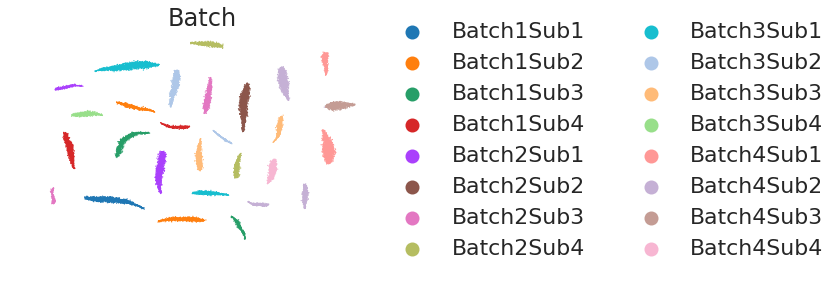

conos draw graph


'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches

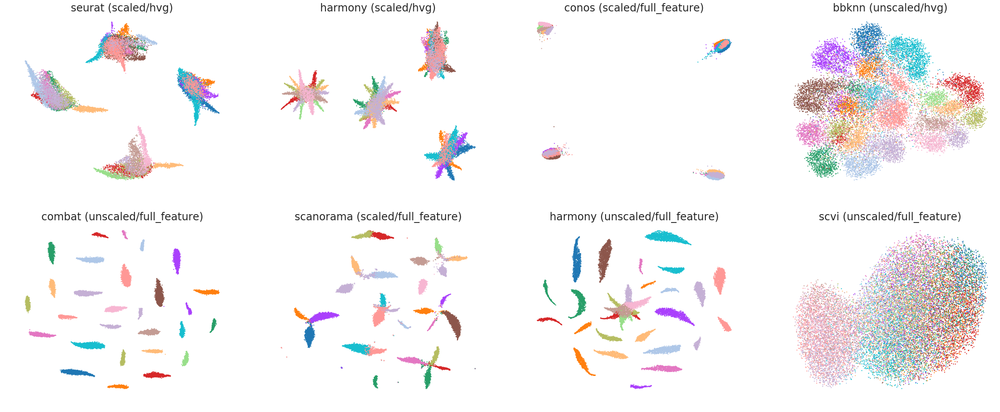

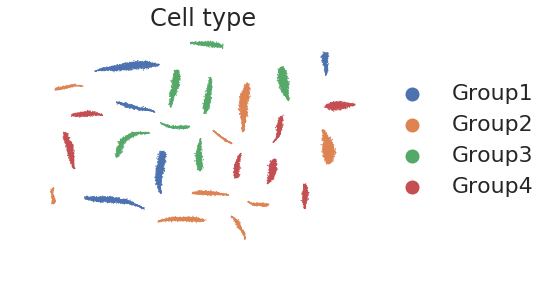

conos draw graph


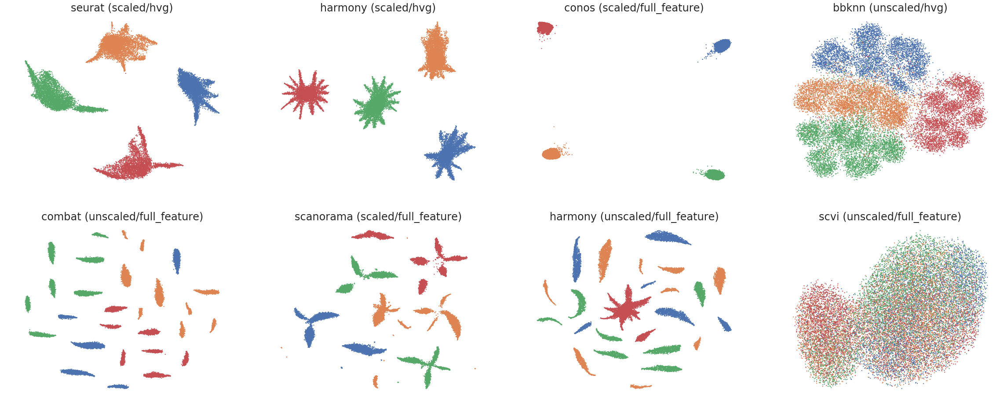

In [44]:
draw_figure(sim2_base, sim2_pre, sim2_best, sim2_worst, sim2_best_types, sim2_worst_types, sim2_batch, sim2_ct)

In [54]:
draw_figure(brain_base, brain_pre, brain_best, brain_worst, brain_best_types, brain_worst_types, brain_batch, brain_ct)

Data reading successful
HVG
Calculating 2000 HVGs for reduce_data.


MemoryError: Unable to allocate array with shape (1068535623,) and data type float32